In [1]:
"""
script to load sim and plot
"""

from netpyne import sim
from matplotlib import pyplot as plt
import os
import pickle as pkl
import numpy as np


Start time:  2025-04-28 14:25:16.429405
Loading file v8_batch1/v8_batch1_0_0_data.pkl ... 
  Done; file loading time = 15.71 s
Loading simConfig...
Loading netParams...
Loading net...
  Created 33738 cells
  Created 0 connections
  Created 331544 stims
  Done; re-instantiate net time = 3.15 s
Loading simData...
Recording 0 traces of 0 types on node 0
Preparing spike data...
Plotting spike frequency...
Preparing spike data...


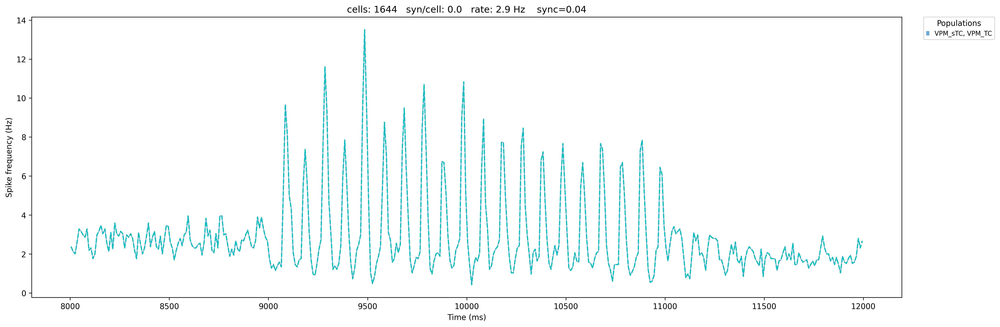

In [2]:
FR_TC = []
vl = []

for ib in range(1,2):

    filename = 'v8_batch'+str(ib)  + '/' +'v8_batch'+str(ib) + '_0_0_data.pkl'

    sim.load(filename, instantiate=True, instantiateConns = False, instantiateStims = False, instantiateRxD = False, createNEURONObj = False)


    timeRange = [8000,12000]  # 'VPM_TC','ss_RTN_m', 
    binSize = 10
    sim.analysis.plotSpikeHist(include=[['VPM_sTC', 'VPM_TC']], binSize=binSize, figSize=(18, 6.0), fontSize = 12, legend=False, showFig= False,
                                        timeRange = timeRange, graphType = 'bar', measure = 'rate', linewidth=5, dpi=300, saveData=False, saveFig=False);

    SpikeHist = sim.analysis.prepareSpikeHist(include=[['VPM_sTC', 'VPM_TC']], timeRange = timeRange)
    aa, bb, = np.histogram(SpikeHist['spkTimes'],bins=range(timeRange[0],timeRange[1]+1,binSize))
    timefactor = binSize*1644/(1000)
    plt.plot(bb[1:]-binSize/2, aa/timefactor, 'c--')
    plt.show()
    FR_TC.append(aa/timefactor)

    for val in sim.cfg.IClamp[2:]:
        vl.append(val['start'])
    # sim.analysis.plotRaster(**{'include': ['VPM_TC','ss_RTN_m','VPM_sTC'], 'saveFig': False, 'showFig': False, 'popRates': True,'orderInverse': True, 
    #                         'timeRange': timeRange, 'figSize': (8,4), 'fontSize':4, 'lw': 1, 'markerSize':1, 'marker': 'o', 'dpi': 200})
    
    # for pop in ['VPM_sTC', 'VPM_TC','ss_RTN_m']:
    #     sim.analysis.plotTraces(include= [pop], timeRange=timeRange, overlay=True, oneFigPer='trace', ylim=[-90,65], subtitles= True, axis=True, scaleBarLoc=1, 
    #                         figSize=(12, 4), fontSize=8, showFig=False, saveFig=False);

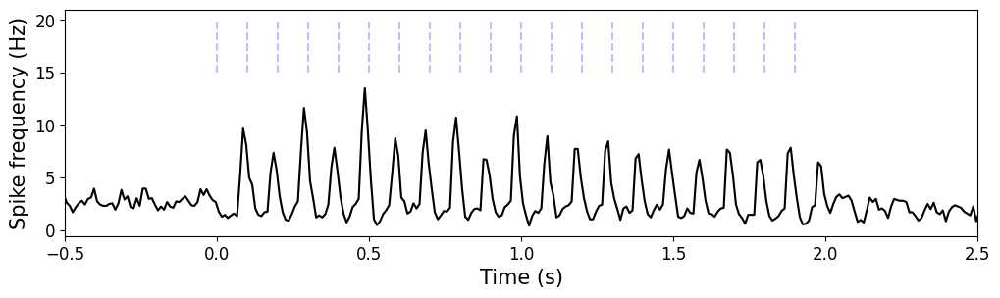

In [3]:
plt.figure(figsize=(12,3))
for i in range(1):
    plt.plot((bb[1:]-9000-binSize/2)/1000, FR_TC[i],'gray', alpha =0.25)
plt.plot((bb[1:]-9000-binSize/2)/1000, np.mean(FR_TC, axis=0),'k')
plt.ylabel('Spike frequency (Hz)', size= 15)
plt.xlabel('Time (s)', size= 15)
plt.yticks(size= 12)
plt.xlim(-0.5,2.5)
plt.vlines((np.array(vl)-9000)/1000, ymin=15,ymax = 20, color='blue', linestyles='dashed', alpha =0.25)
# plt.plot([2.0,2.0], [0,20],'--k')
plt.xticks(size= 12);

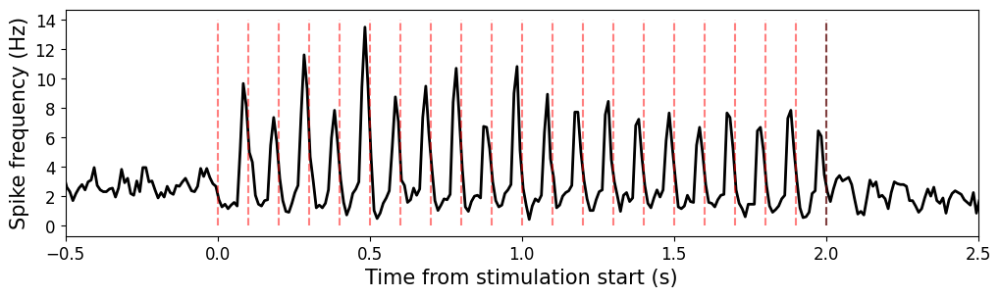

In [4]:
mean = np.mean(FR_TC, axis=0) # Calculate mean across series (axis 0)
std_dev = np.std(FR_TC, axis=0) # Calculate standard deviation across series (axis 0)
x = (bb[1:]-9000-binSize/2)/1000

plt.figure(figsize=(12,3))

# Plot the mean line
plt.plot(x, mean, label='Mean', color='black', linewidth=2)
plt.fill_between(x, mean - std_dev, mean + std_dev, color='gray', alpha=0.5, label='Mean ± 1 Std Dev')

plt.ylabel('Spike frequency (Hz)', size= 15)
plt.xlabel('Time from stimulation start (s)', size= 15)
plt.yticks(size= 12)
plt.xlim(-0.5,2.5)
plt.vlines(np.linspace(0,2.0,21), ymin=0,ymax = 14, color='red',linestyles='dashed', alpha =0.5)
plt.plot([2.0,2.0], [0,14],'--k', alpha =0.5)
plt.xticks(size= 12);


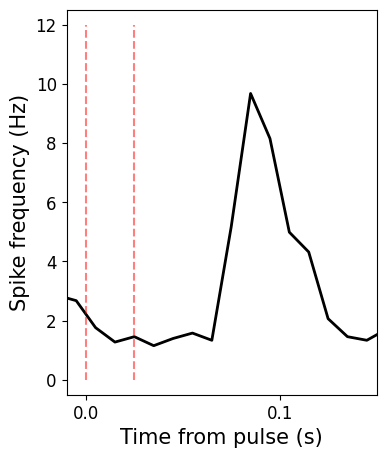

In [5]:
mean = np.mean(FR_TC, axis=0) # Calculate mean across series (axis 0)
std_dev = np.std(FR_TC, axis=0) # Calculate standard deviation across series (axis 0)
x = (bb[1:]-9000-binSize/2)/1000

plt.figure(figsize=(4,5))

# Plot the mean line
plt.plot(x, mean, label='Mean', color='black', linewidth=2)
plt.fill_between(x, mean - 2*std_dev, mean + 2*std_dev, color='gray', alpha=0.5, label='Mean ± 1 Std Dev')

plt.ylabel('Spike frequency (Hz)', size= 15)
plt.xlabel('Time from pulse (s)', size= 15)
plt.yticks(size= 12)
plt.xlim(-0.01,0.15)
# plt.vlines((np.array(vl)-9000)/1000, ymin=10,ymax = 15, color='blue', linestyles='dashed', alpha =0.25)
plt.vlines(np.linspace(0,0.025,2), ymin=0,ymax = 12, color='red',linestyles='dashed', alpha =0.5)
# plt.plot([2.0,2.0], [0,20],'--k')
plt.ylim(-0.5,12.5)
plt.xticks([0,0.10],size= 12);


Plotting recorded cell traces ... trace
Plotting recorded cell traces ... trace
Plotting recorded cell traces ... trace


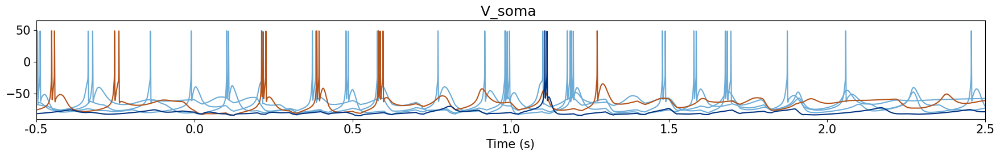

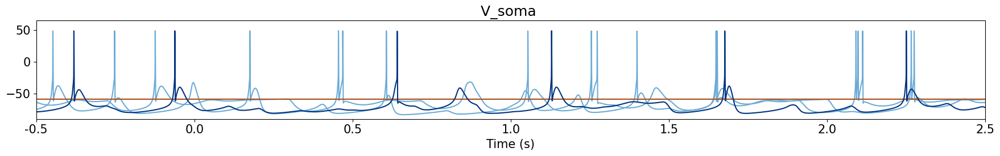

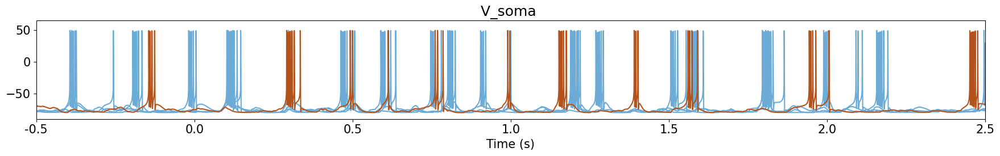

In [6]:
for pop in ['VPM_sTC', 'VPM_TC','ss_RTN_m']:
        sim.analysis.plotTraces(include= [pop], timeRange=timeRange, overlay=True, oneFigPer='trace', ylim=[-90,65], subtitles= True, axis=True, scaleBarLoc=1, 
                            figSize=(18, 3), fontSize=15, showFig=False, saveFig=False);
        plt.xlim(8500,11500)
        plt.xlabel('Time (s)')
        plt.xticks(np.linspace(8500,11500,7),np.linspace(-0.5,2.5,7));

Preparing spike data...
Plotting raster...


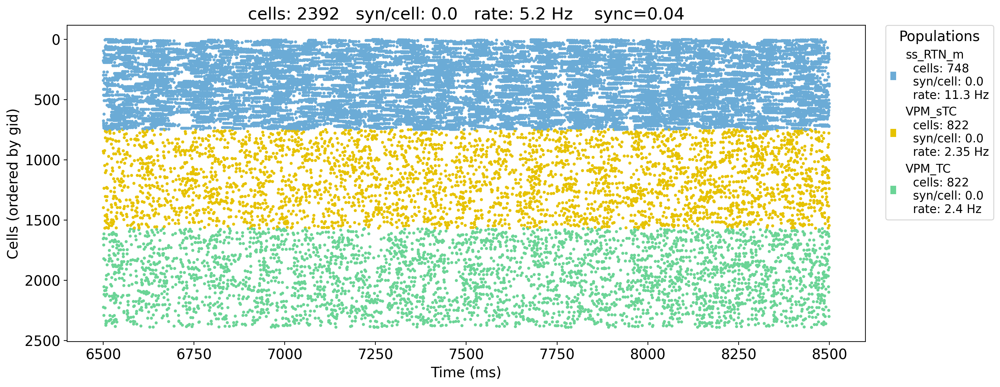

In [7]:
sim.analysis.plotRaster(**{'include': ['VPM_TC','ss_RTN_m','VPM_sTC'], 'saveFig': False, 'showFig': False, 'popRates': True,'orderInverse': True, 
                            'timeRange': [6500,8500], 'figSize': (15,6), 'fontSize':8, 'lw': 1, 'markerSize':1, 'marker': 'o', 'dpi': 200})
# plt.xlim(8500,11500)
# plt.xlabel('Time (s)')
# plt.xticks(np.linspace(500,8500,7),np.linspace(-0.5,2.5,7));


Preparing spike data...
Plotting raster...


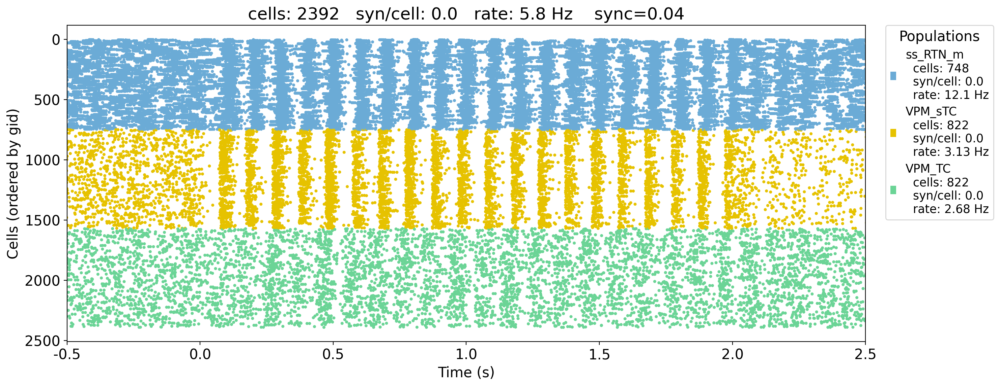

In [8]:
sim.analysis.plotRaster(**{'include': ['VPM_TC','ss_RTN_m','VPM_sTC'], 'saveFig': False, 'showFig': False, 'popRates': True,'orderInverse': True, 
                            'timeRange': timeRange, 'figSize': (15,6), 'fontSize':8, 'lw': 1, 'markerSize':1, 'marker': 'o', 'dpi': 200})
plt.xlim(8500,11500)
plt.xlabel('Time (s)')
plt.xticks(np.linspace(8500,11500,7),np.linspace(-0.5,2.5,7));


Preparing spike data...
Plotting raster...


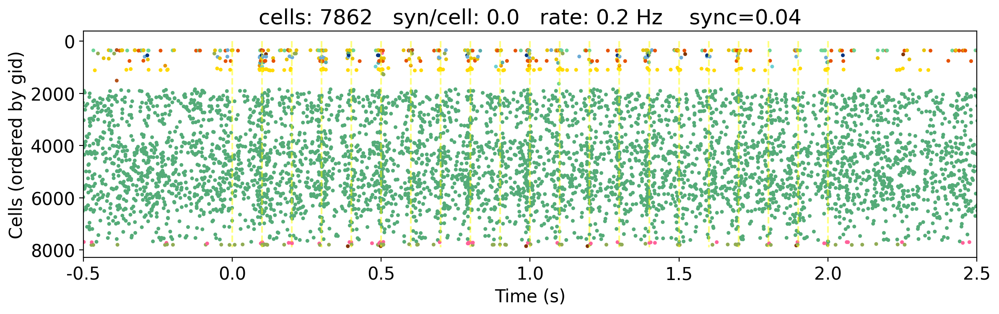

In [9]:
sim.analysis.plotRaster(**{'include': sim.cfg.S1cells[0:57], 'saveFig': False, 'showFig': False, 'popRates': True,'orderInverse': True, 'labels': None,
                                'timeRange': timeRange, 'figSize': (12,4), 'fontSize':4, 'lw': 1, 'markerSize':1, 'marker': 'o', 'dpi': 200})
plt.xlim(8500,11500)
plt.xlabel('Time (s)')
plt.vlines(np.linspace(9000,11000,21), ymin=0,ymax = 7900, color='yellow',linestyles='dashed', alpha =0.5)
plt.xticks(np.linspace(8500,11500,7),np.linspace(-0.5,2.5,7));
plt.show()


Preparing spike data...
Plotting raster...


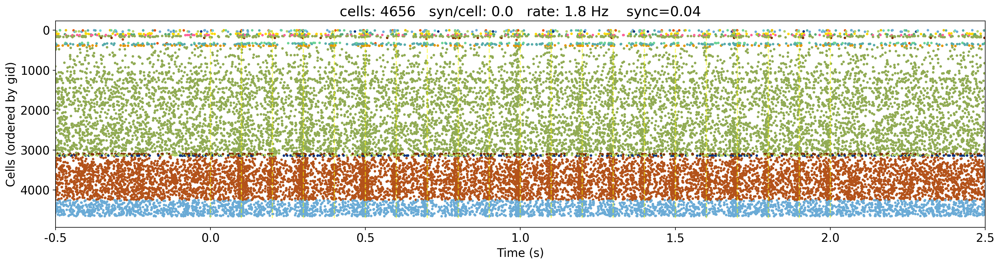

In [10]:
sim.analysis.plotRaster(**{'include': sim.cfg.S1cells[57:103], 'saveFig': False, 'showFig': False, 'popRates': True,'orderInverse': True, 'labels': None,
                                'timeRange': timeRange, 'figSize': (18,5), 'fontSize':4, 'lw': 1, 'markerSize':1, 'marker': 'o', 'dpi': 200})
plt.xlim(8500,11500)
plt.xlabel('Time (s)')
plt.vlines(np.linspace(9000,11000,21), ymin=0,ymax = 4700, color='yellow',linestyles='dashed', alpha =0.5)
plt.xticks(np.linspace(8500,11500,7),np.linspace(-0.5,2.5,7));
plt.show()


Preparing spike data...
Plotting raster...


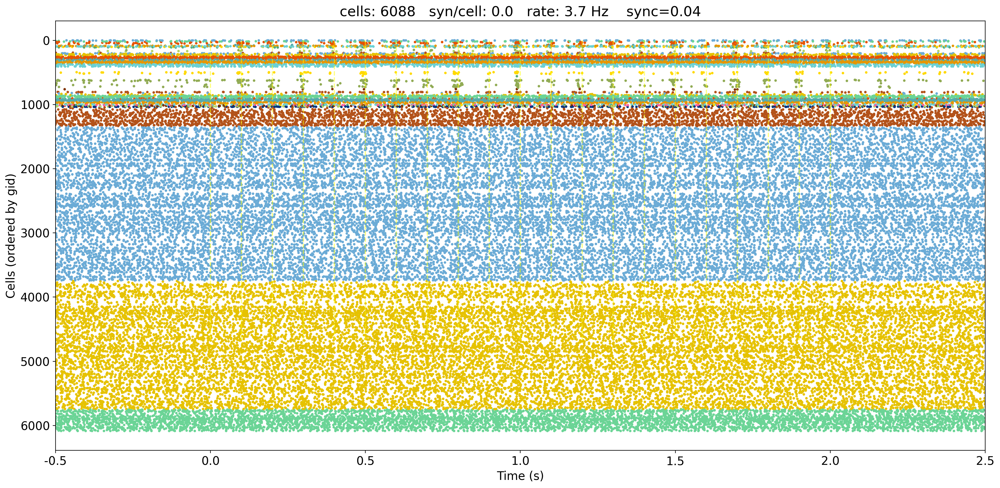

In [11]:
sim.analysis.plotRaster(**{'include': sim.cfg.S1cells[107:155], 'saveFig': False, 'showFig': False, 'popRates': True,'orderInverse': True, 'labels': None,
                                'timeRange': timeRange, 'figSize': (18,9), 'fontSize':4, 'lw': 1, 'markerSize':1, 'marker': 'o', 'dpi': 200})
plt.xlim(8500,11500)
plt.xlabel('Time (s)')
plt.vlines(np.linspace(9000,11000,21), ymin=0,ymax = 4700, color='yellow',linestyles='dashed', alpha =0.5)
plt.xticks(np.linspace(8500,11500,7),np.linspace(-0.5,2.5,7));
plt.show()


Preparing spike data...
Plotting raster...


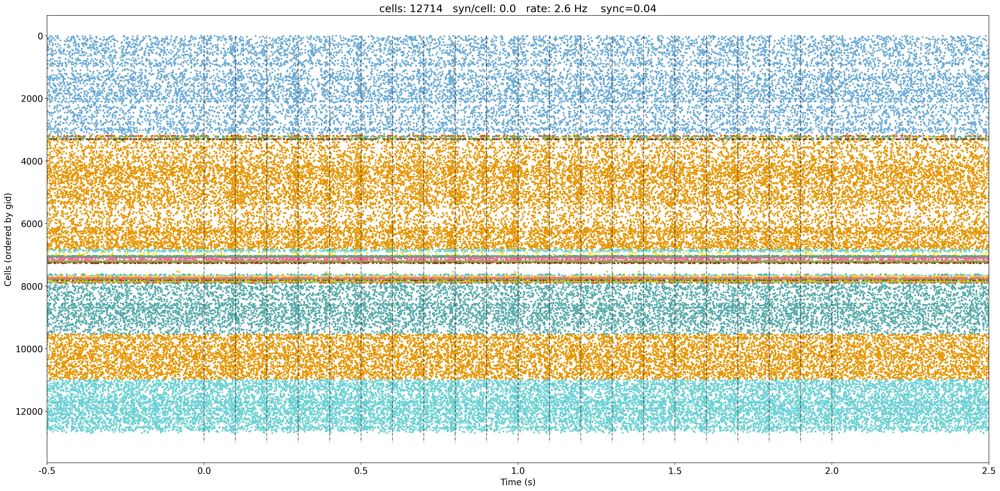

In [12]:
sim.analysis.plotRaster(**{'include': sim.cfg.S1cells[155:207], 'saveFig': False, 'showFig': False, 'popRates': True,'orderInverse': True, 'labels': None,
                                'timeRange': timeRange, 'figSize': (24,12), 'fontSize':4, 'lw': 1, 'markerSize':1, 'marker': 'o', 'dpi': 200})
plt.xlim(8500,11500)
plt.xlabel('Time (s)')
plt.vlines(np.linspace(9000,11000,21), ymin=0,ymax = 13000, color='black',linestyles='dashed', alpha =0.5)
plt.xticks(np.linspace(8500,11500,7),np.linspace(-0.5,2.5,7));
plt.show()

Plotting recorded cell traces ... trace


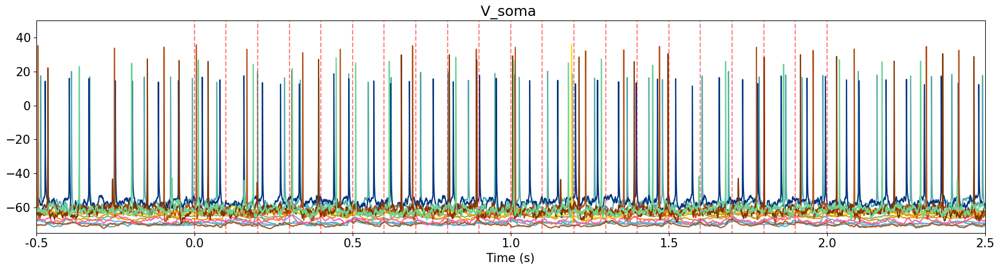

In [13]:
timeRange = [8000,12000]
# # 'presyn_VPL_sTC', 'presyn_VPM_sTC', 'presyn_POm_sTC_s1'
# sim.analysis.plotRaster(**{'include': sim.cfg.S1cells, 'saveFig': False, 'showFig': False, 'popRates': True,'orderInverse': True, 
#                            'timeRange': timeRange, 'figSize': (15,7), 'fontSize':4, 'lw': 1, 'markerSize':1, 'marker': 'o', 'dpi': 200})

# for pop in sim.cfg.S1cells[57:103]:
#     if pop in ['L4_PC_cAD', 'L4_SP_cAD', 'L4_SS_cAD']:
sim.analysis.plotTraces(include= ['L4_PC_cAD', 'L4_SP_cAD', 'L4_SS_cAD'], timeRange=timeRange, overlay=True, oneFigPer='trace', ylim=[-75,50], subtitles= True, axis=True, scaleBarLoc=1, 
                            figSize=(18, 5), fontSize=15, showFig=False, saveFig=False);
# sim.analysis.plotRaster(**{'include': sim.cfg.S1cells, 'saveFig': False, 'showFig': False, 'popRates': True,'orderInverse': True, 
#                            'timeRange': timeRange, 'figSize': (15,7), 'fontSize':4, 'lw': 1, 'markerSize':1, 'marker': 'o', 'dpi': 200})
plt.xlim(8500,11500)
plt.xlabel('Time (s)')
plt.vlines(np.linspace(9000,11000,21), ymin=-80,ymax = 50, color='red',linestyles='dashed', alpha =0.5)
plt.xticks(np.linspace(8500,11500,7),np.linspace(-0.5,2.5,7));

Preparing spike data...
Plotting spike frequency...


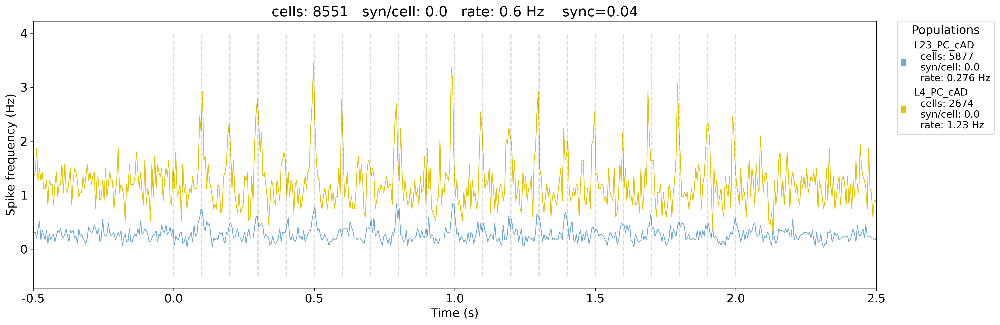

In [30]:
timeRange = [8000,12000]
sim.analysis.plotSpikeHist(include= ['L23_PC_cAD', 'L4_PC_cAD'], binSize=5, figSize=(18, 6.0), fontSize = 12, legend=False, showFig= False,
                                    timeRange = timeRange, graphType = 'bar', measure = 'rate', linewidth=5, dpi=300, saveData=False, saveFig=False);
plt.xlim(8500,11500)
plt.xlabel('Time (s)')
plt.vlines(np.linspace(9000,11000,21), ymin=-0.5,ymax = 4, color='black',linestyles='dashed', alpha =0.15)
plt.xticks(np.linspace(8500,11500,7),np.linspace(-0.5,2.5,7));

Preparing spike data...
Plotting spike frequency...


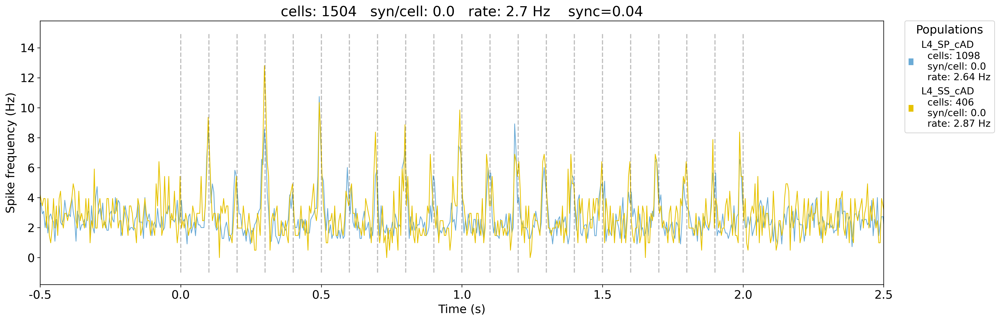

In [27]:
timeRange = [8000,12000]
sim.analysis.plotSpikeHist(include= ['L4_SP_cAD', 'L4_SS_cAD'], binSize=5, figSize=(18, 6.0), fontSize = 12, legend=False, showFig= False,
                                    timeRange = timeRange, graphType = 'bar', measure = 'rate', linewidth=5, dpi=300, saveData=False, saveFig=False);
plt.xlim(8500,11500)
plt.xlabel('Time (s)')
plt.vlines(np.linspace(9000,11000,21), ymin=-1,ymax = 15, color='black',linestyles='dashed', alpha =0.25)
plt.xticks(np.linspace(8500,11500,7),np.linspace(-0.5,2.5,7));

Preparing spike data...
Plotting spike frequency...


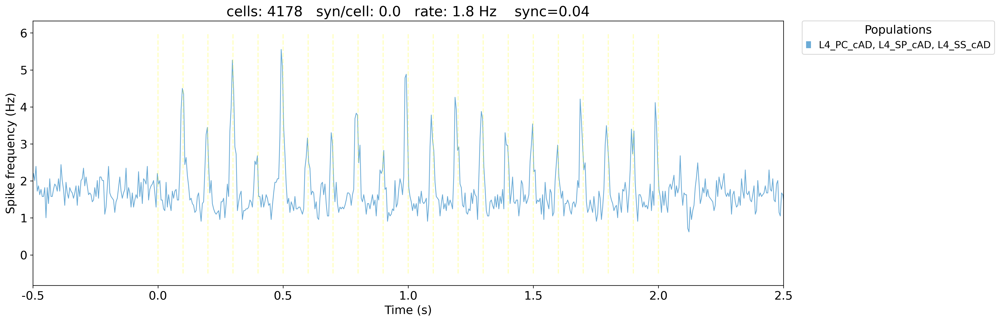

In [40]:
timeRange = [8000,12000]
sim.analysis.plotSpikeHist(include= [['L4_SP_cAD', 'L4_SS_cAD', 'L4_PC_cAD']], binSize=5, figSize=(18, 6.0), fontSize = 12, legend=False, showFig= False,
                                    timeRange = timeRange, graphType = 'bar', measure = 'rate', linewidth=5, dpi=300, saveData=False, saveFig=False);
plt.xlim(8500,11500)
plt.xlabel('Time (s)')
plt.vlines(np.linspace(9000,11000,21), ymin=-0.5,ymax = 6, color='yellow',linestyles='dashed', alpha =0.25)
plt.xticks(np.linspace(8500,11500,7),np.linspace(-0.5,2.5,7));

Preparing spike data...
Plotting spike frequency...


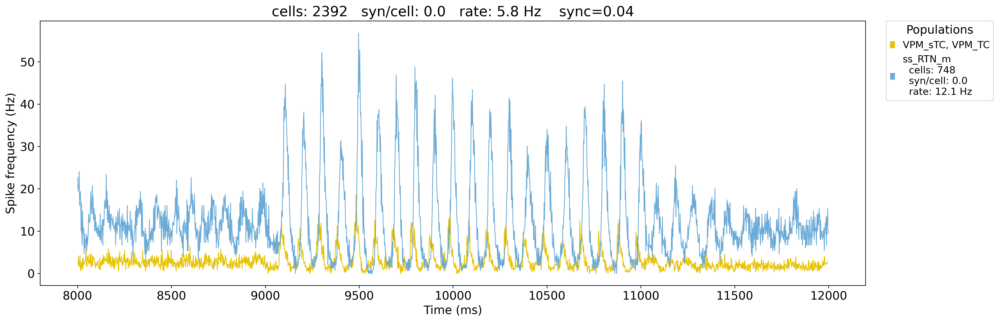

In [14]:
sim.analysis.plotSpikeHist(include=[['VPM_sTC', 'VPM_TC'],'ss_RTN_m'], binSize=2, figSize=(18, 6.0), fontSize = 12, legend=False, showFig= False,
                                    timeRange = timeRange, graphType = 'bar', measure = 'rate', linewidth=5, dpi=300, saveData=False, saveFig=False);

In [15]:
# sim.analysis.plotLFP(**{'plots': ['timeSeries'],
#                 'electrodes': [0, 1], 'lineWidth': 8, 
#                 # 'filtFreq': [200,400], 'filtOrder': 5,
#                 # 'timeRange': [6040,6080], 
#                 'timeRange': [2000,12000], 'dpi':300,
#         'figSize': (12.0,3), 'saveFig': "LFPTimeSeries.png", 'showFig': False})
# # sim.analysis.plotLFP(**{'plots': ['timeSeries'],
# #                 'electrodes': [0, 1], 'lineWidth': 8, 
# #                 'filtFreq': [2,40], 'filtOrder': 2,
# #                 # 'timeRange': [6040,6080], 
# #                 'timeRange': [1000,6000], 'dpi':300,
# #         'figSize': (12.0,3), 'saveFig': "LFPTimeSeries.png", 'showFig': False})

In [16]:
# np.shape(sim.simData['LFP'])